In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [3]:
df = pd.read_csv('../../df_normalized_encoded.csv')

df.head()

,semi_major_axis,eccentricity,inclination,longitude_node,perihelion,perihelion_distance,aphelion_distance,orbital_period,data_arc,n_obs_used,absolute_magnitude,diameter,albedo,min_orbit_intersection,mean_motion,mean_anomaly,near_earth_object_N,near_earth_object_Y,physical_hazardous_asteroid_N,physical_hazardous_asteroid_Y
0,-0.507630,0.249189,-0.373376,-1.188765,-1.433350,-0.762226,-0.302052,-0.147092,8.133003,3.468336,-4.631043,9.155872,1.037744,-0.763128,0.700901,1.230759,0.077199,-0.077199,0.03832,-0.03832
1,-0.514063,-1.010012,-0.785863,-1.013740,-0.206433,-0.274327,-0.498700,-0.148760,8.054713,4.426078,-3.952145,6.852597,1.046813,-0.333389,0.714139,0.061231,0.077199,-0.077199,0.03832,-0.03832
2,-0.715834,-0.780444,-0.101824,0.162283,-0.472614,-0.645042,-0.592504,-0.200239,7.783764,3.327287,-4.211499,8.294674,0.638693,-0.687464,1.163836,0.327977,0.077199,-0.077199,0.03832,-0.03832
3,-0.869666,-1.045657,-1.381633,-0.099080,0.667505,-0.765284,-0.726954,-0.238404,6.846989,3.889743,-3.372412,4.875320,0.194296,-0.788116,1.558003,0.431769,0.077199,-0.077199,0.03832,-0.03832
4,-0.293410,-1.454459,-0.567600,-1.274602,-0.482708,0.224671,-0.432387,-0.090671,7.273796,3.154894,-4.585274,8.851156,0.928912,0.207375,0.293646,-1.605449,0.077199,-0.077199,0.03832,-0.03832


In [4]:
df = df[['semi_major_axis', 'eccentricity', 'inclination', 'longitude_node',
       'perihelion', 'perihelion_distance', 'aphelion_distance',
       'orbital_period', 'data_arc', 'n_obs_used', 'absolute_magnitude',
       'albedo', 'min_orbit_intersection', 'mean_motion',
       'mean_anomaly', 'near_earth_object_N', 'near_earth_object_Y',
       'physical_hazardous_asteroid_N', 'physical_hazardous_asteroid_Y', 'diameter']]
df.head()

,semi_major_axis,eccentricity,inclination,longitude_node,perihelion,perihelion_distance,aphelion_distance,orbital_period,data_arc,n_obs_used,absolute_magnitude,albedo,min_orbit_intersection,mean_motion,mean_anomaly,near_earth_object_N,near_earth_object_Y,physical_hazardous_asteroid_N,physical_hazardous_asteroid_Y,diameter
0,-0.507630,0.249189,-0.373376,-1.188765,-1.433350,-0.762226,-0.302052,-0.147092,8.133003,3.468336,-4.631043,1.037744,-0.763128,0.700901,1.230759,0.077199,-0.077199,0.03832,-0.03832,9.155872
1,-0.514063,-1.010012,-0.785863,-1.013740,-0.206433,-0.274327,-0.498700,-0.148760,8.054713,4.426078,-3.952145,1.046813,-0.333389,0.714139,0.061231,0.077199,-0.077199,0.03832,-0.03832,6.852597
2,-0.715834,-0.780444,-0.101824,0.162283,-0.472614,-0.645042,-0.592504,-0.200239,7.783764,3.327287,-4.211499,0.638693,-0.687464,1.163836,0.327977,0.077199,-0.077199,0.03832,-0.03832,8.294674
3,-0.869666,-1.045657,-1.381633,-0.099080,0.667505,-0.765284,-0.726954,-0.238404,6.846989,3.889743,-3.372412,0.194296,-0.788116,1.558003,0.431769,0.077199,-0.077199,0.03832,-0.03832,4.875320
4,-0.293410,-1.454459,-0.567600,-1.274602,-0.482708,0.224671,-0.432387,-0.090671,7.273796,3.154894,-4.585274,0.928912,0.207375,0.293646,-1.605449,0.077199,-0.077199,0.03832,-0.03832,8.851156


# Subset Selection

In [4]:
# Subset selection
features = ['semi_major_axis', 'eccentricity', 'inclination', 'orbital_period', 'data_arc', 'n_obs_used', 
            'absolute_magnitude', 'albedo', 'min_orbit_intersection', 'mean_motion', 'mean_anomaly', 'near_earth_object_N', 'near_earth_object_Y']

In [5]:
# # Subset selection (as per ridge and lasso regression)

# features = ["semi_major_axis" , "eccentricity", "inclination" ,"longitude_node", "perihelion" , "perihelion_distance","aphelion_distance", 
# "orbital_period" , "data_arc" , "n_obs_used" , "absolute_magnitude" ,"albedo" , "min_orbit_intersection","mean_motion" , "mean_anomaly",                
# "near_earth_object_N","near_earth_object_Y", "physical_hazardous_asteroid_N" ,"physical_hazardous_asteroid_Y"]

# Divide the dataset into features and the dependent variable

In [6]:
X = df[features]
X.head()

,semi_major_axis,eccentricity,inclination,orbital_period,data_arc,n_obs_used,absolute_magnitude,albedo,min_orbit_intersection,mean_motion,mean_anomaly,near_earth_object_N,near_earth_object_Y
0,-0.507630,0.249189,-0.373376,-0.147092,8.133003,3.468336,-4.631043,1.037744,-0.763128,0.700901,1.230759,0.077199,-0.077199
1,-0.514063,-1.010012,-0.785863,-0.148760,8.054713,4.426078,-3.952145,1.046813,-0.333389,0.714139,0.061231,0.077199,-0.077199
2,-0.715834,-0.780444,-0.101824,-0.200239,7.783764,3.327287,-4.211499,0.638693,-0.687464,1.163836,0.327977,0.077199,-0.077199
3,-0.869666,-1.045657,-1.381633,-0.238404,6.846989,3.889743,-3.372412,0.194296,-0.788116,1.558003,0.431769,0.077199,-0.077199
4,-0.293410,-1.454459,-0.567600,-0.090671,7.273796,3.154894,-4.585274,0.928912,0.207375,0.293646,-1.605449,0.077199,-0.077199


In [7]:
y = df[['diameter']].values
y

array([[ 9.15587155],
       [ 6.85259661],
       [ 8.29467409],
       ...,
       [-0.58126607],
       [-0.43202299],
       [-0.86573635]])

# Split the data into training and test sets

In [8]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [9]:
X_train.head()

,semi_major_axis,eccentricity,inclination,orbital_period,data_arc,n_obs_used,absolute_magnitude,albedo,min_orbit_intersection,mean_motion,mean_anomaly,near_earth_object_N,near_earth_object_Y
36938,-0.478112,0.331227,-0.319758,-0.139421,-0.245838,-0.306906,0.372967,-0.331725,-0.762725,0.640962,-0.875420,0.077199,-0.077199
806,-0.793757,0.278366,-0.875579,-0.219690,4.179174,3.170566,-1.915452,1.736082,-1.160308,1.357363,-0.896264,0.077199,-0.077199
92616,-0.393960,-0.361550,-1.002989,-0.117370,0.097267,-0.301682,0.678089,-0.531250,-0.390047,0.477016,-0.033914,0.077199,-0.077199
33968,-0.191930,-0.635029,-1.148770,-0.063343,-0.135980,0.225947,0.220405,0.357544,-0.024941,0.121162,1.479704,0.077199,-0.077199
50688,-0.867586,0.109444,-1.460943,-0.237895,-0.137423,0.016985,0.830650,-0.676359,-1.250876,1.552337,0.193661,0.077199,-0.077199


In [10]:
X_test.head()

,semi_major_axis,eccentricity,inclination,orbital_period,data_arc,n_obs_used,absolute_magnitude,albedo,min_orbit_intersection,mean_motion,mean_anomaly,near_earth_object_N,near_earth_object_Y
69164,0.419403,0.715995,-0.495862,0.109122,0.117291,0.008278,-0.389840,-0.785191,0.175281,-0.708242,-1.536828,0.077199,-0.077199
19410,0.066744,-0.064588,0.394189,0.008017,2.705553,0.189378,-0.542401,-0.186615,0.140790,-0.269021,0.698260,0.077199,-0.077199
50834,-0.568329,-1.192828,-0.811367,-0.162761,-0.213368,1.121000,-0.542401,0.475445,-0.282225,0.828369,0.224278,0.077199,-0.077199
24803,0.090752,3.377658,3.535376,0.014762,0.795023,0.130173,-1.839172,-0.640082,-1.442830,-0.302034,0.002605,0.077199,-0.077199
106285,0.563375,-1.297382,0.810264,0.151625,0.007071,-0.824086,0.220405,-0.830538,1.408711,-0.862814,0.296519,0.077199,-0.077199


In [11]:
y_train

array([[-0.53843979],
       [ 0.17636967],
       [-0.38945626],
       ...,
       [-0.87170608],
       [-1.2241793 ],
       [-0.62798564]])

In [12]:
y_test

array([[ 0.78502188],
       [ 0.22231059],
       [-0.21763206],
       ...,
       [ 0.14288731],
       [ 0.45980175],
       [-0.6170844 ]])

# Random Forests regression

In [17]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV  
from sklearn.metrics import r2_score, mean_squared_error
  
# defining parameter range
param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [10, 20],
    'min_samples_leaf': [50, 100]
}

# Create an instance of GridSearchCV

grid = GridSearchCV(RandomForestRegressor(), param_grid, refit = True, verbose = -1, cv=5)

grid.fit(X_train, y_train)

# Get the best params
best_params = grid.best_params_

# print best parameter after tuning
print("The best parameters after tuning are: ", best_params)
  
# print how our model looks after hyper-parameter tuning
print("The best model after tuning looks like: ",grid.best_estimator_)

# Create a new instance of random forest regressor using the best hyperparameters
rf_best = RandomForestRegressor(n_estimators=best_params['n_estimators'],
                                 max_depth=best_params['max_depth'],
                                 min_samples_leaf=best_params['min_samples_leaf'])

# Fit the best model to the training data
rf_best.fit(X_train, y_train)

# Use the best model to make predictions on the train data
y_pred_train = rf_best.predict(X_train)

# Use the best model to make predictions on the test data
y_pred = rf_best.predict(X_test)

# Evaluate the performance of the best model on the train and test data

# rmse = np.sqrt(np.square(np.subtract(y_test, y_pred)).mean())

rmse_train = mean_squared_error(y_train, y_pred, squared=False)
print("Train RMSE:", rmse_train)

rmse_test = mean_squared_error(y_test, y_pred, squared=False)
print("Test RMSE:", rmse_test)

# Calculate the R-squared value
r2 = r2_score(y_test, y_pred)
# r2 = rf_best.score(X_test, y_test)

print("Test R-squared:", r2)


# Calculate the number of observations and independent variables
n = X_test.shape[0]
k = X_test.shape[1]

# Calculate the adjusted R-squared value
adjusted_r2 = 1 - ((1 - r2) * (n - 1) / (n - k - 1))

print("Test Adjusted R-squared:", adjusted_r2)

The best parameters after tuning are:  {'max_depth': 20, 'min_samples_leaf': 50, 'n_estimators': 50}
The best model after tuning looks like:  RandomForestRegressor(max_depth=20, min_samples_leaf=50, n_estimators=50)
RMSE: 0.17585353554578528
R-squared: 0.9698586886191151
Adjusted R-squared: 0.9698441729101445


# Variable Importance for RF (13 VARIABLES)

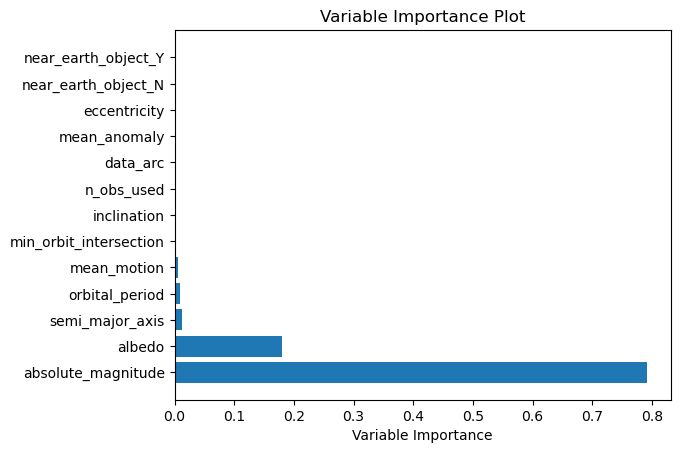

In [18]:
# Get the variable importances
importances = rf_best.feature_importances_

# Sort the importances in descending order
sorted_idx = importances.argsort()[::-1]

# Plot the variable importances
plt.barh(range(X.shape[1]), importances[sorted_idx])
plt.yticks(range(X.shape[1]), X.columns[sorted_idx])
plt.xlabel('Variable Importance')
plt.title('Random Forest Variable Importance Plot ')
plt.show()

# Lasso

In [5]:
lasso_features = ['data_arc', 'absolute_magnitude', 'albedo', 'min_orbit_intersection']

# Divide the dataset into features and the dependent variable

In [6]:
X1 = df[lasso_features]
X1.head()

,data_arc,absolute_magnitude,albedo,min_orbit_intersection
0,8.133003,-4.631043,1.037744,-0.763128
1,8.054713,-3.952145,1.046813,-0.333389
2,7.783764,-4.211499,0.638693,-0.687464
3,6.846989,-3.372412,0.194296,-0.788116
4,7.273796,-4.585274,0.928912,0.207375


In [7]:
y1 = df[['diameter']].values
y1

array([[ 9.15587155],
       [ 6.85259661],
       [ 8.29467409],
       ...,
       [-0.58126607],
       [-0.43202299],
       [-0.86573635]])

# Split the data into training and test sets

In [8]:
from sklearn.model_selection import train_test_split
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

In [9]:
X1_train.head()

,data_arc,absolute_magnitude,albedo,min_orbit_intersection
36938,-0.245838,0.372967,-0.331725,-0.762725
806,4.179174,-1.915452,1.736082,-1.160308
92616,0.097267,0.678089,-0.531250,-0.390047
33968,-0.135980,0.220405,0.357544,-0.024941
50688,-0.137423,0.830650,-0.676359,-1.250876


In [10]:
X1_test.head()

,data_arc,absolute_magnitude,albedo,min_orbit_intersection
69164,0.117291,-0.389840,-0.785191,0.175281
19410,2.705553,-0.542401,-0.186615,0.140790
50834,-0.213368,-0.542401,0.475445,-0.282225
24803,0.795023,-1.839172,-0.640082,-1.442830
106285,0.007071,0.220405,-0.830538,1.408711


In [11]:
y1_train

array([[-0.53843979],
       [ 0.17636967],
       [-0.38945626],
       ...,
       [-0.87170608],
       [-1.2241793 ],
       [-0.62798564]])

In [12]:
y1_test

array([[ 0.78502188],
       [ 0.22231059],
       [-0.21763206],
       ...,
       [ 0.14288731],
       [ 0.45980175],
       [-0.6170844 ]])

# Random Forests for Lasso

In [13]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV  
from sklearn.metrics import r2_score, mean_squared_error
  
# defining parameter range
param_grid = {
    'n_estimators': [50, 100],
    'max_depth': [10, 20],
    'min_samples_leaf': [50, 100]
}

# Create an instance of GridSearchCV

grid1 = GridSearchCV(RandomForestRegressor(), param_grid, refit = True, verbose = -1, cv=5)

grid1.fit(X1_train, y1_train)

# Get the best params
best_params1 = grid1.best_params_

# print best parameter after tuning
print("The best parameters after tuning are: ", best_params1)
  
# print how our model looks after hyper-parameter tuning
print("The best model after tuning looks like: ",grid1.best_estimator_)

# Create a new instance of random forest regressor using the best hyperparameters
rf1_best = RandomForestRegressor(n_estimators=best_params1['n_estimators'],
                                 max_depth=best_params1['max_depth'],
                                 min_samples_leaf=best_params1['min_samples_leaf'])

# Fit the best model to the training data
rf1_best.fit(X1_train, y1_train)

# Use the best model to make predictions on the train data
y1_pred_train = rf1_best.predict(X1_train)

# Use the best model to make predictions on the test data
y1_pred_test = rf1_best.predict(X1_test)

# Evaluate the performance of the best model on the train and test data

lasso_rmse_train = mean_squared_error(y1_train, y1_pred_train, squared=False)
print("Train RMSE:", lasso_rmse_train)

# lasso_rmse = np.sqrt(np.square(np.subtract(y1_test, y1_pred)).mean())
lasso_rmse = mean_squared_error(y1_test, y1_pred_test, squared=False)
print("Test RMSE:", lasso_rmse)

# Calculate the R-squared value
lasso_r2 = r2_score(y1_test, y1_pred_test)
# r2 = rf_best.score(X_test, y_test)

print("R-squared:", lasso_r2)


# Calculate the number of observations and independent variables
n1 = X1_test.shape[0]
k1 = X1_test.shape[1]

# Calculate the adjusted R-squared value
lasso_adjusted_r2 = 1 - ((1 - lasso_r2) * (n1 - 1) / (n1 - k1 - 1))

print("Adjusted R-squared:", lasso_adjusted_r2)

The best parameters after tuning are:  {'max_depth': 20, 'min_samples_leaf': 50, 'n_estimators': 100}
The best model after tuning looks like:  RandomForestRegressor(max_depth=20, min_samples_leaf=50)
Train RMSE: 0.16534258603993876
Test RMSE: 0.17774074339793114
R-squared: 0.9692082820791121
Adjusted R-squared: 0.9692037208499271


# Variable Importance for RF (4 VARIABLES)

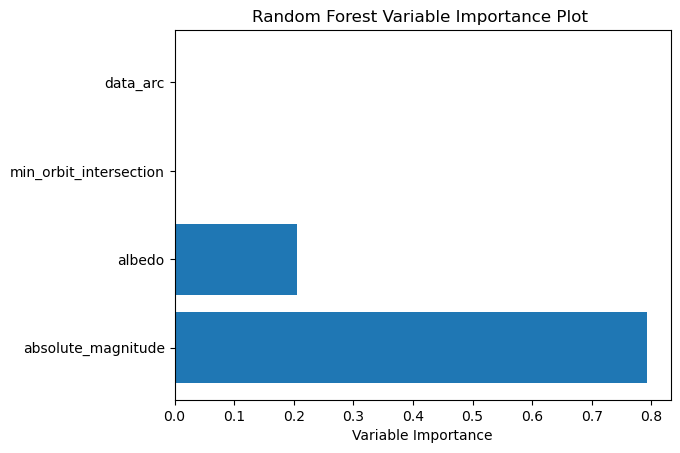

In [49]:
# Get the variable importances
importances = rf1_best.feature_importances_

# Sort the importances in descending order
sorted_idx = importances.argsort()[::-1]

# Plot the variable importances
plt.barh(range(X1_train.shape[1]), importances[sorted_idx])
plt.yticks(range(X1_train.shape[1]), X1_train.columns[sorted_idx])
plt.xlabel('Variable Importance')
plt.title('Random Forest Variable Importance Plot ')
plt.show()

# Train Set Parity Plot for RF (4 VARIABLES) 

Text(0, 0.5, 'Prediction (Asteroid Diameter Normalized)')

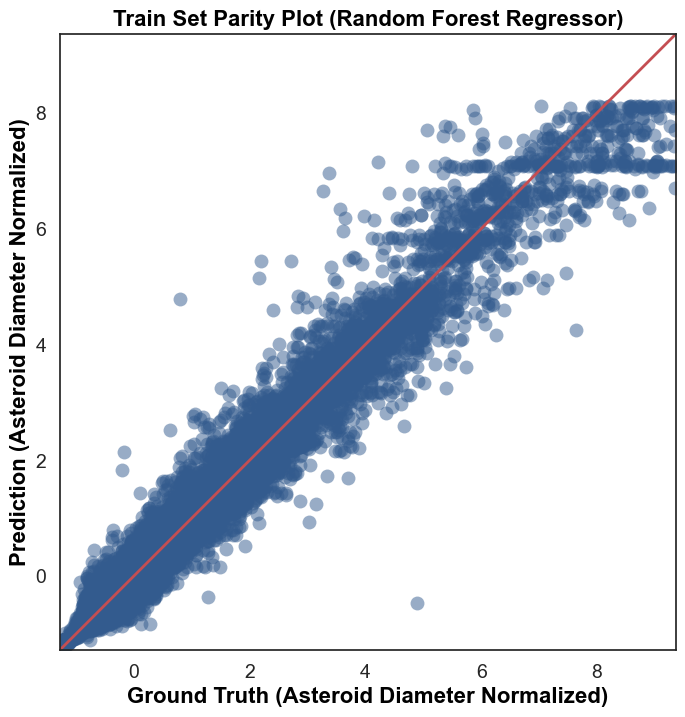

In [38]:
sns.set(style="white", color_codes=True)

# Font for figure for publishing
font_axis_publish = {
        'color':  'black',
        'weight': 'bold',
        'size': 16,
        }
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 14

# Define a custom color palette with a darker blue
custom_palette = sns.color_palette(["#335B8E"])

# Set the custom color palette
sns.set_palette(custom_palette)

# Plot Figures
fignow = plt.figure(figsize=(8,8))

x = y1_train
y = y1_pred_train

## find the boundaries of X and Y values
bounds = (min(x.min(), y.min()) - int(0.1 * y.min()), max(x.max(), y.max())+ int(0.1 * y.max()))

# Reset the limits
ax = plt.gca()
ax.set_xlim(bounds)
ax.set_ylim(bounds)
# Ensure the aspect ratio is square
ax.set_aspect("equal", adjustable="box")

plt.plot(x,y,"o", alpha=0.5 ,ms=10, markeredgewidth=0.0)

ax.plot([0, 1], [0, 1], "r-",lw=2 ,transform=ax.transAxes)

# Title and labels 
plt.title("Train Set Parity Plot (Random Forest Regressor)", fontdict=font_axis_publish)
plt.xlabel('Ground Truth (Asteroid Diameter Normalized)', fontdict=font_axis_publish)
plt.ylabel('Prediction (Asteroid Diameter Normalized)', fontdict=font_axis_publish)

# Test Set Parity Plot for RF (4 VARIABLES) 

Text(0, 0.5, 'Prediction (Asteroid Diameter Normalized)')

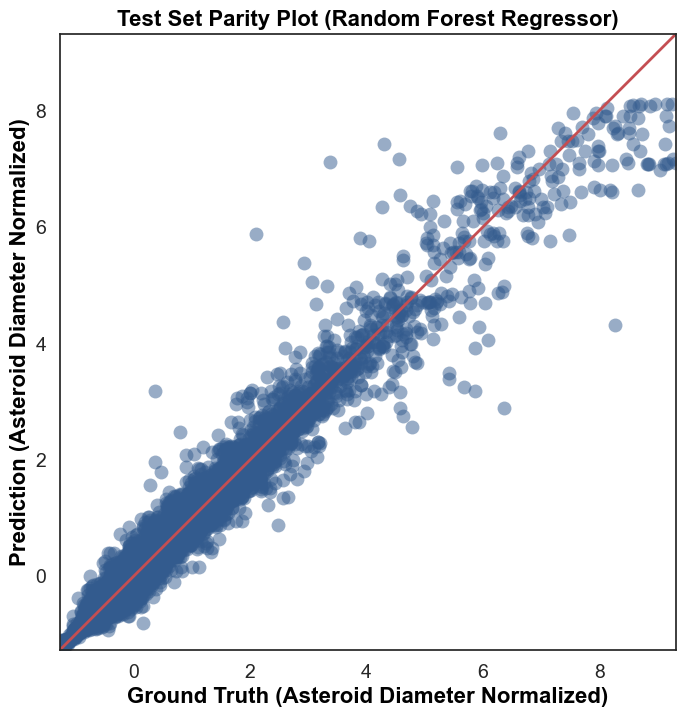

In [37]:
sns.set(style="white", color_codes=True)

# Font for figure for publishing
font_axis_publish = {
        'color':  'black',
        'weight': 'bold',
        'size': 16,
        }
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 14

# Define a custom color palette with a darker blue
custom_palette = sns.color_palette(["#335B8E"])

# Set the custom color palette
sns.set_palette(custom_palette)

# Plot Figures
fignow = plt.figure(figsize=(8,8))

x = y1_test
y = y1_pred_test

## find the boundaries of X and Y values
bounds = (min(x.min(), y.min()) - int(0.1 * y.min()), max(x.max(), y.max())+ int(0.1 * y.max()))

# Reset the limits
ax = plt.gca()
ax.set_xlim(bounds)
ax.set_ylim(bounds)
# Ensure the aspect ratio is square
ax.set_aspect("equal", adjustable="box")

plt.plot(x,y,"o", alpha=0.5 ,ms=10, markeredgewidth=0.0)

ax.plot([0, 1], [0, 1], "r-",lw=2 ,transform=ax.transAxes)

# Title and labels 
plt.title("Test Set Parity Plot (Random Forest Regressor)", fontdict=font_axis_publish)
plt.xlabel('Ground Truth (Asteroid Diameter Normalized)', fontdict=font_axis_publish)
plt.ylabel('Prediction (Asteroid Diameter Normalized)', fontdict=font_axis_publish)

In [22]:
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook_connected"
import plotly.express as px
import kaleido

fig = px.scatter(x=y1_train.flatten(),y=y1_pred_train.flatten(),height=600,width=800, opacity=0.4, title="Parity Plot (Random Forest Regressor)", color_discrete_sequence=['#297db1'])
fig['data'][0]['showlegend']=True
fig['data'][0]['name']='Train Set'
fig.add_scatter(x=y1_test.flatten(),y=y1_pred_test.flatten(),mode="markers", opacity=0.4, name="Test Set")
fig.add_scatter(x=y1_train.flatten(),y=y1_train.flatten(), mode='lines', line_width=2, opacity=1, name="y=x")

fig.update_layout(
    xaxis_title='Ground Truth (Asteroid Diameter Normalized)',
    yaxis_title='Prediction (Asteroid Diameter Normalized)',
    template="plotly_white",
    showlegend=True,
    title_x=0.5
)

fig.show()

pio.write_image(fig, 'parity_plot_train_test_rf.png', format='png', width=800, height=600, scale=3)

# Bar Plot for RMSE's

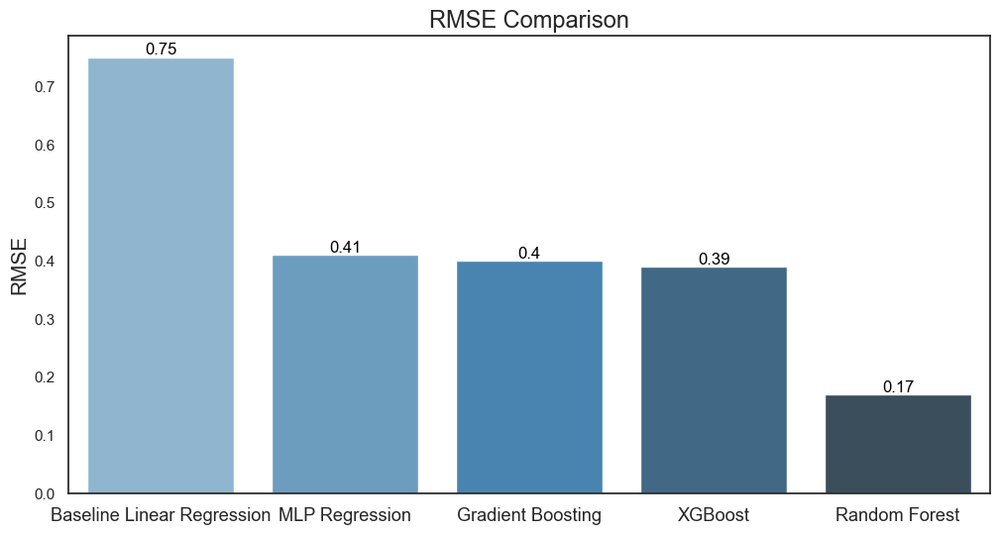

In [84]:
models = ['Baseline Linear Regression', 'MLP Regression', 'Gradient Boosting', 'XGBoost', 'Random Forest']
test_rmse = [0.75, 0.41, 0.40, 0.39, 0.18]
train_rmse = [0.75, 0.41, 0.40, 0.39, 0.16]

# Bar Plot with Blues Palette (increase dpi)

plt.figure(figsize=(12, 6))
# Sort the bar plot in descending order of RMSE
sns.barplot(x=models, y=rmse, palette="Blues_d", order=sorted(models, key=lambda x: rmse[models.index(x)], reverse=True))
plt.title('Test Set RMSE (in kilometers) Comparison', fontsize=17)
plt.xlabel('', fontsize=1)
plt.ylabel('RMSE', fontsize=15)
plt.xticks(ticks=[0, 1, 2, 3, 4], fontsize=13.1)
# add annotations
for i, v in enumerate(rmse):
    plt.text(i, v, str(v), ha='center', va='bottom', color='black')
# dpi
plt.savefig('rmse_comparison.png', dpi=300)
